In [30]:
from aquabyte.data_access_utils import RDSAccessUtils, S3AccessUtils
import json
import os
import  pandas as pd
from aquabyte.visualize import Visualizer
import matplotlib.patches as patches
from tqdm import tqdm

import matplotlib.pyplot as plt
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_colwidth', 500)

%matplotlib inline

from PIL import Image, ImageEnhance 
import numpy as np
import matplotlib.pyplot as plt
from random import randint, seed

from os import listdir
from os.path import isfile, join
import random 

In [40]:
from utils import utils
import shutil
import glob

In [6]:
SEED = 33
CROP_WIDTH = 512
CROP_HEIGHT = 512


LABEL_PATH = 'data/lice_crop_labels'
IMAGE_PATH = 'data/lice_crop_images



In [21]:
import importlib
importlib.reload(utils)

<module 'utils.utils' from '/root/jane/cv_research/jane/lice_counting/utils/utils.py'>

fig
[720. 720.]
data/lice_crop_images/left_0_761_2484_1834.jpg


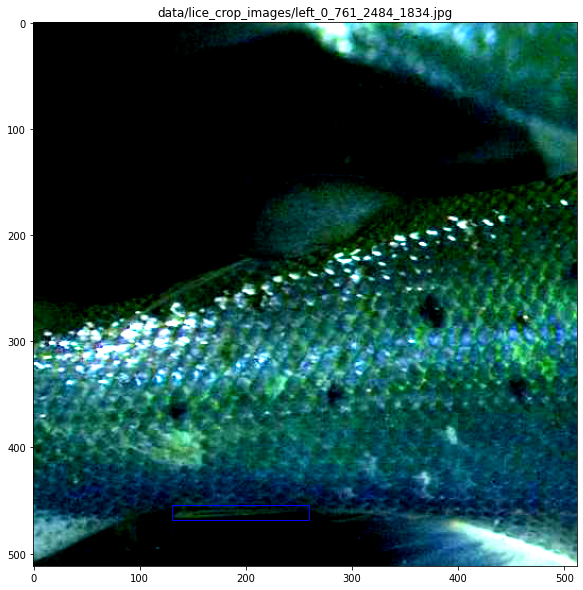

fig
[720. 720.]
data/lice_crop_images/left_0_188_3654_1411.jpg


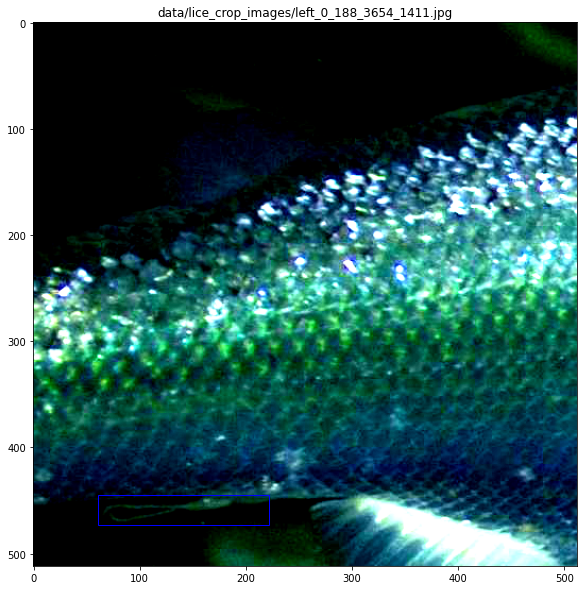

fig
[720. 720.]
data/lice_crop_images/left_978_522_3734_1598.jpg


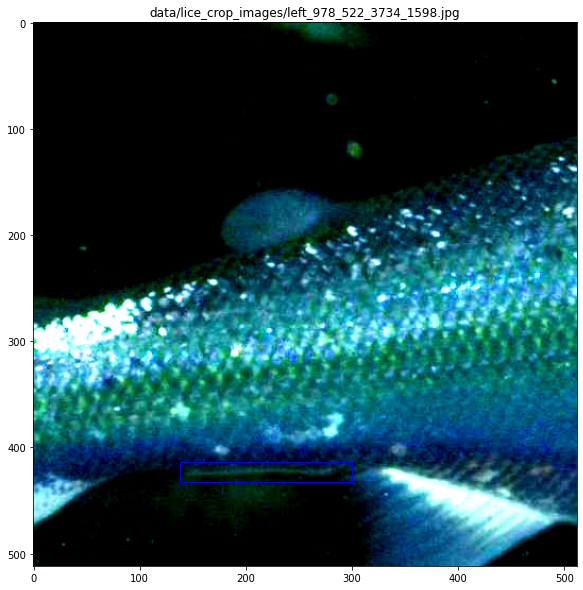

fig
[720. 720.]
data/lice_crop_images/left_514_955_3926_2243.jpg


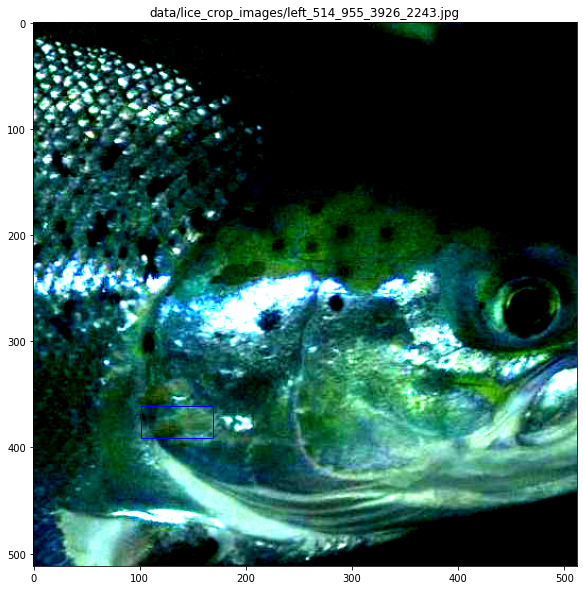

fig
[720. 720.]
data/lice_crop_images/left_858_416_3582_2085.jpg


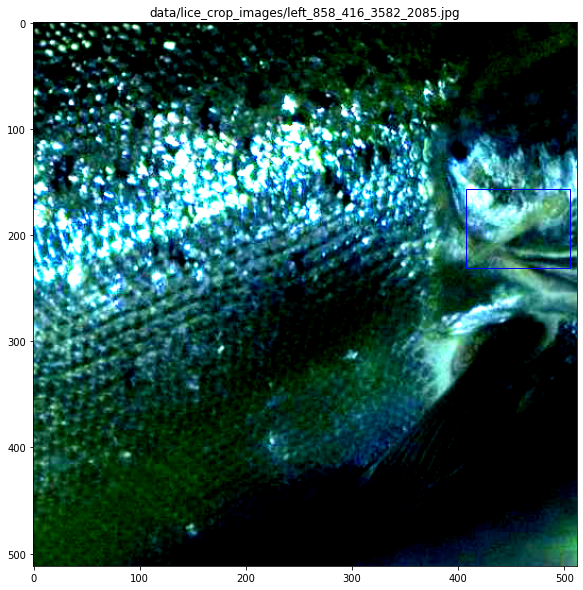

fig
[720. 720.]
data/lice_crop_images/left_1692_1868_3900_2824.jpg


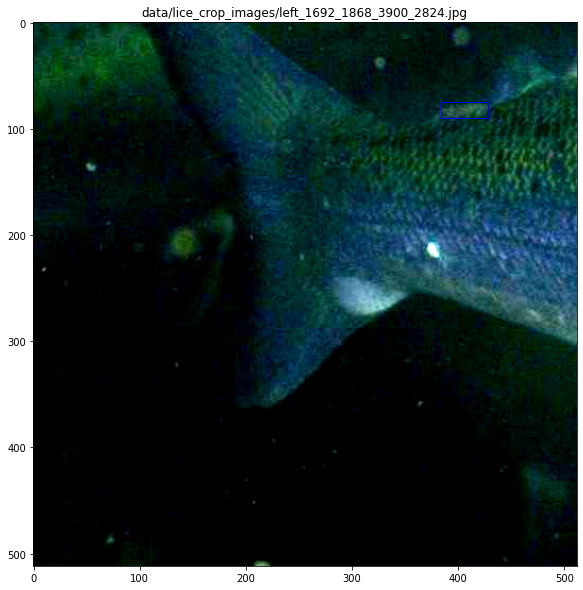

fig
[720. 720.]
data/lice_crop_images/left_1524_808_4096_1805.jpg


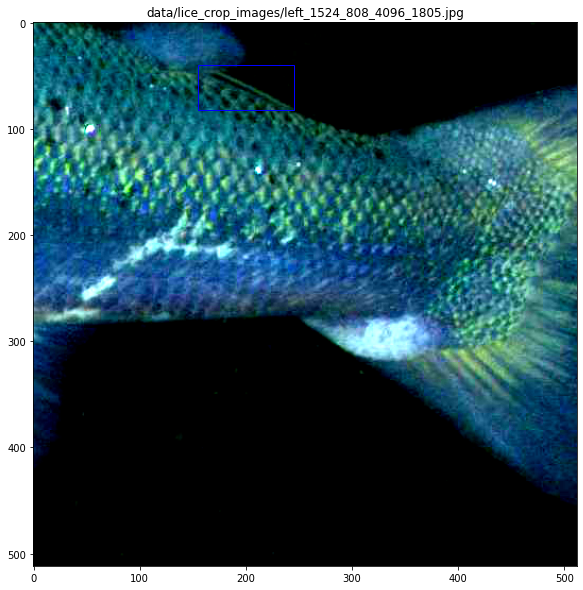

fig
[720. 720.]
data/lice_crop_images/left_610_967_3622_2366.jpg


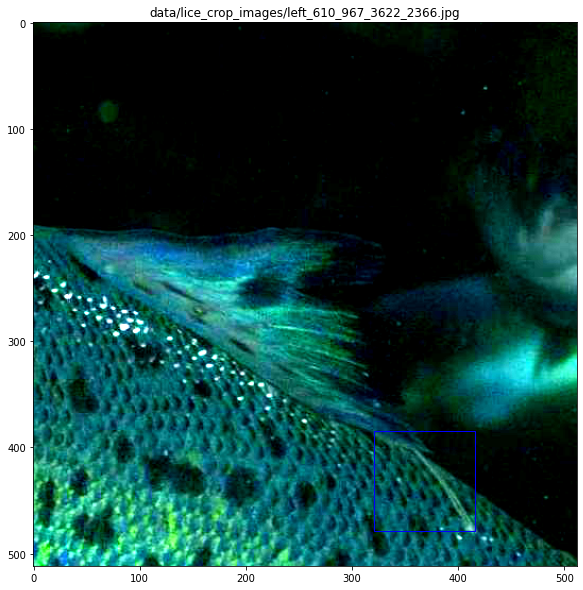

fig
[720. 720.]
data/lice_crop_images/left_1132_1927_3708_2818.jpg


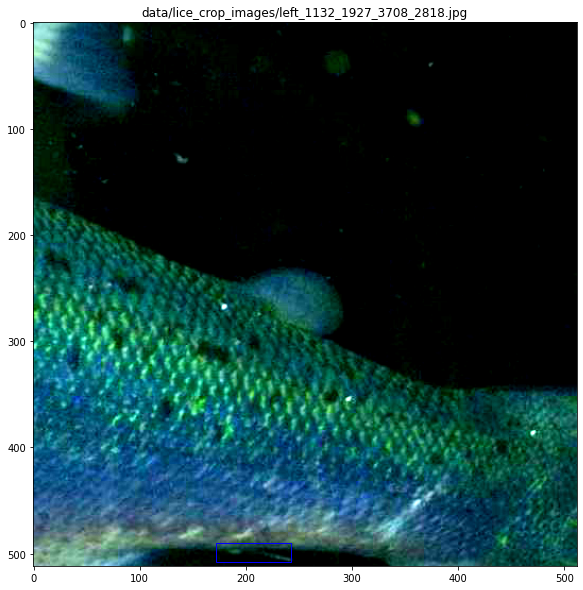

fig
[720. 720.]
data/lice_crop_images/left_1686_1291_3426_2985.jpg


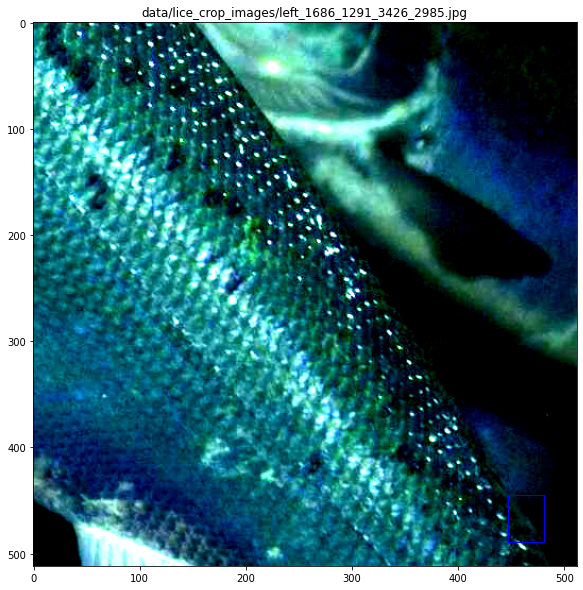

fig
[720. 720.]
data/lice_crop_images/left_154_1236_2838_2882.jpg


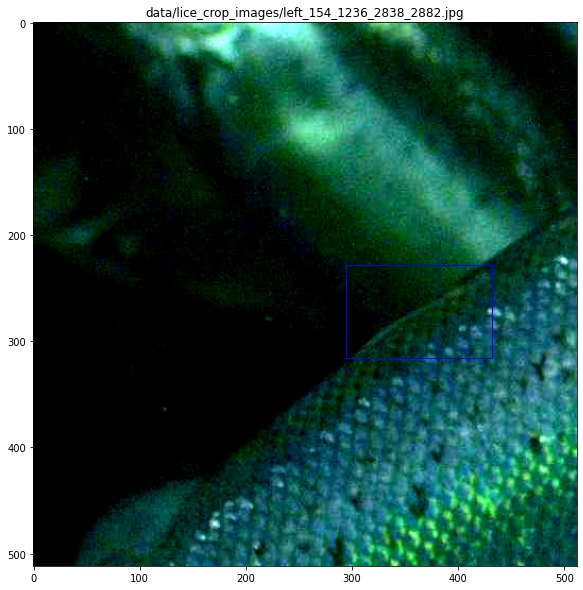

fig
[720. 720.]
data/lice_crop_images/left_1724_638_4096_1635.jpg


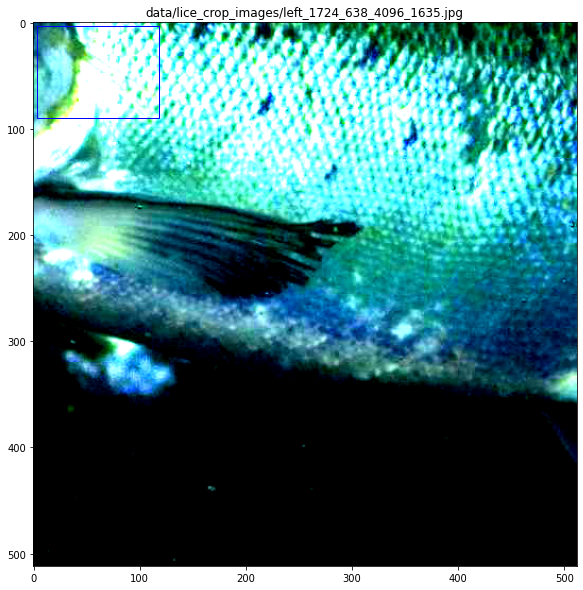

fig
[720. 720.]
data/lice_crop_images/left_140_1288_2908_2566.jpg


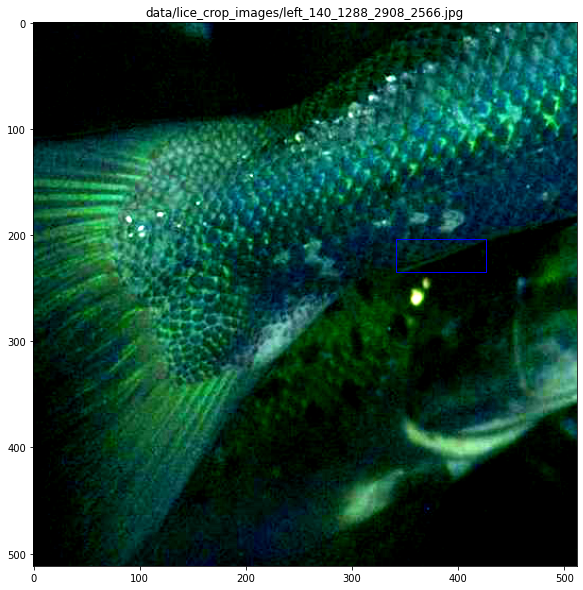

fig
[720. 720.]
data/lice_crop_images/left_2_1494_3054_2864.jpg


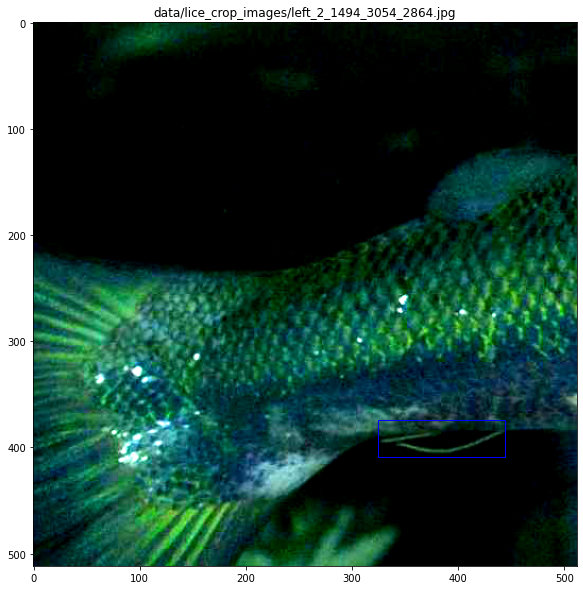

fig
[720. 720.]
data/lice_crop_images/left_338_651_3342_2255.jpg


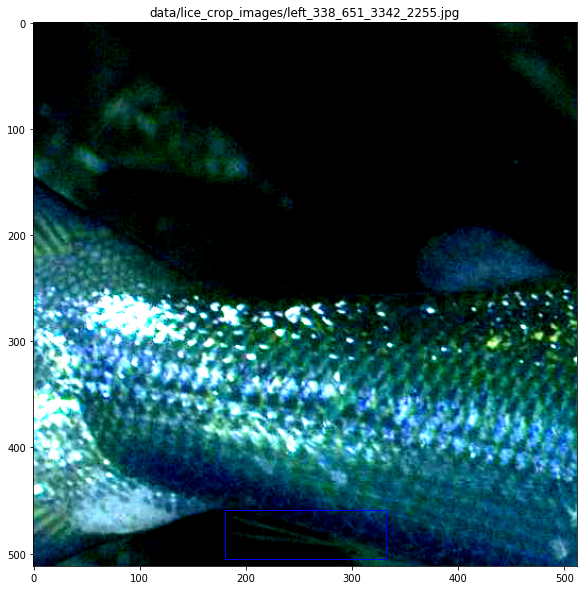

fig
[720. 720.]
data/lice_crop_images/left_858_1735_4046_3000.jpg


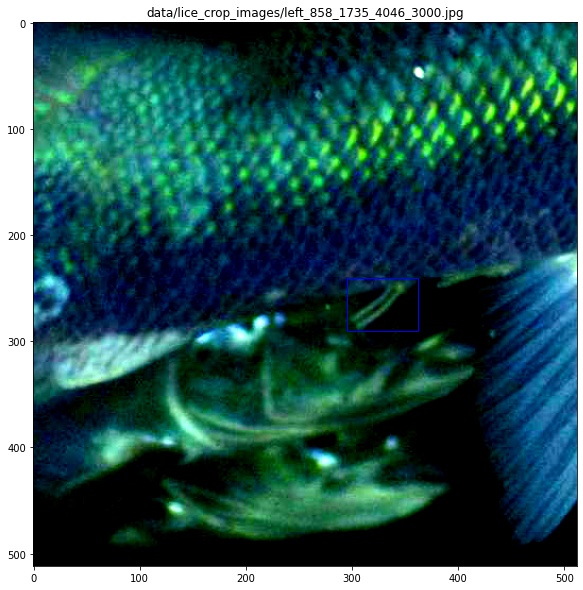

fig
[720. 720.]
data/lice_crop_images/left_0_469_2678_2149.jpg


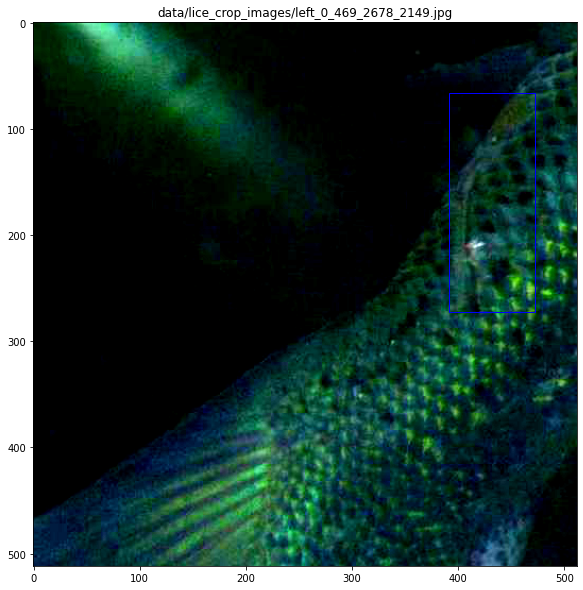

fig
[720. 720.]
data/lice_crop_images/left_12_667_2580_1728.jpg


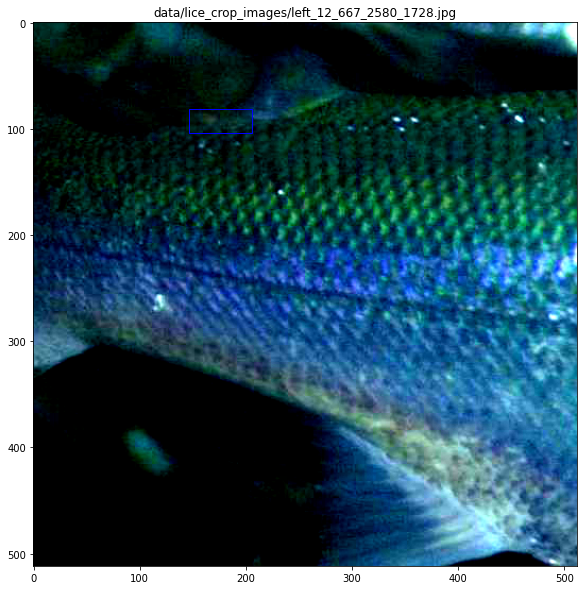

fig
[720. 720.]
data/lice_crop_images/left_1268_0_3596_3000.jpg


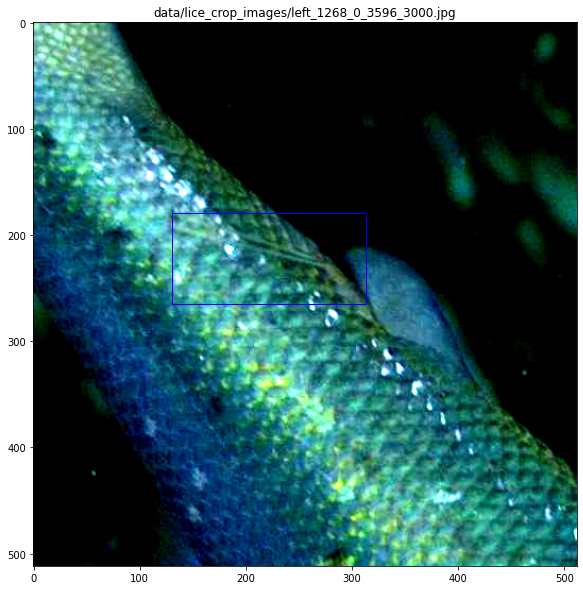

fig
[720. 720.]
data/lice_crop_images/left_500_1200_2940_2607.jpg


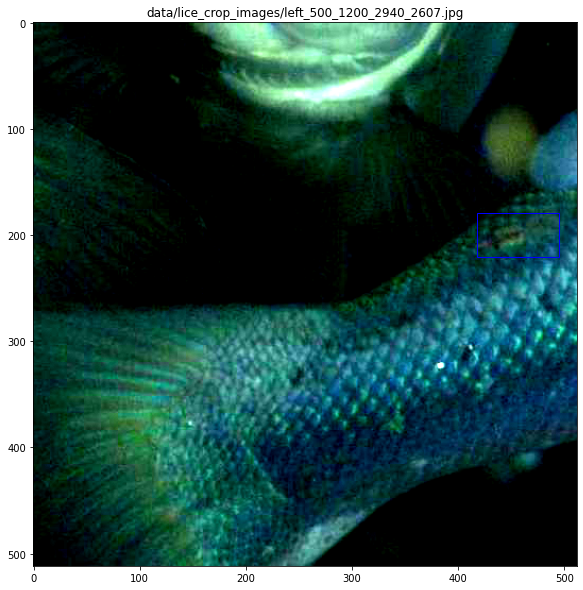

fig
[720. 720.]
data/lice_crop_images/left_1522_885_4096_1921.jpg


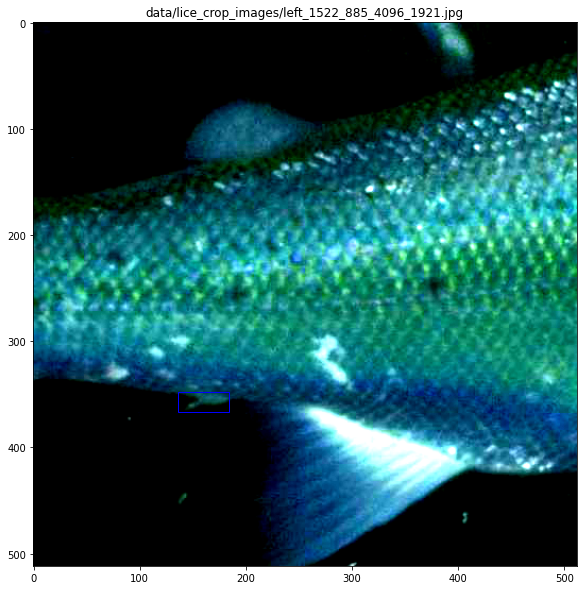

fig
[720. 720.]
data/lice_crop_images/left_1492_702_4004_1699.jpg


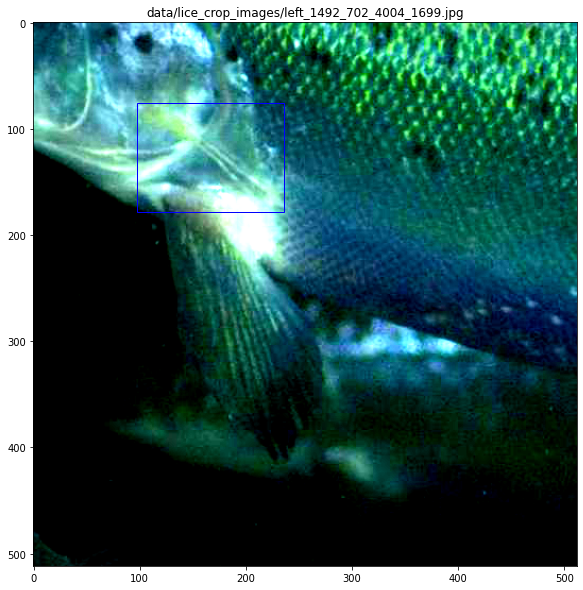

fig
[720. 720.]
data/lice_crop_images/left_0_604_3030_1997.jpg


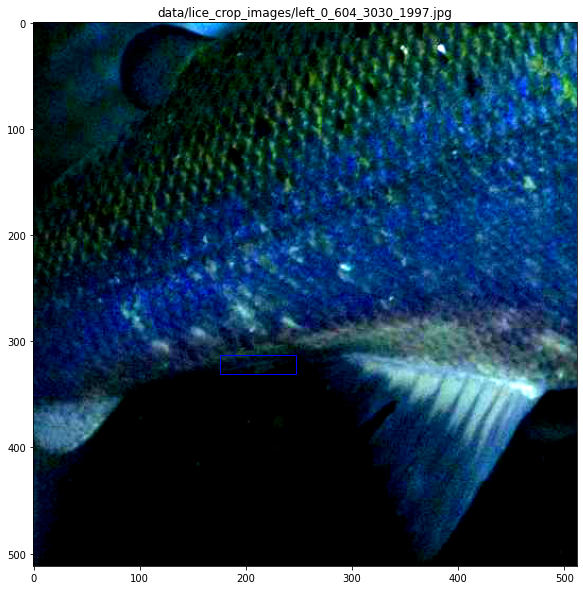

fig
[720. 720.]
data/lice_crop_images/left_1338_1008_3286_2852.jpg


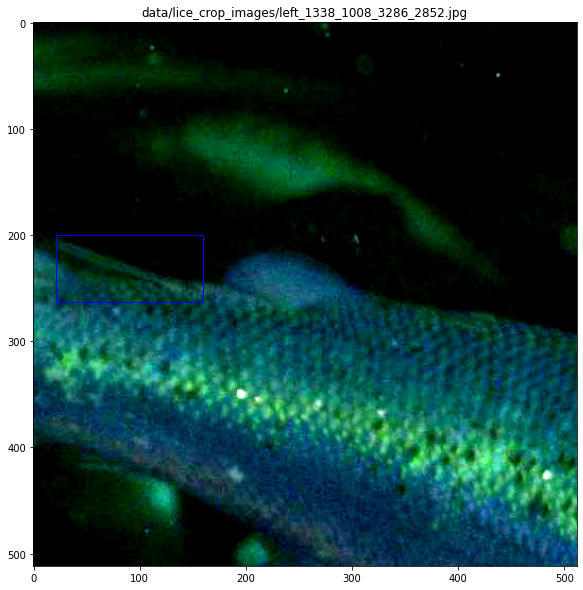

fig
[720. 720.]
data/lice_crop_images/left_428_1476_2652_2648.jpg


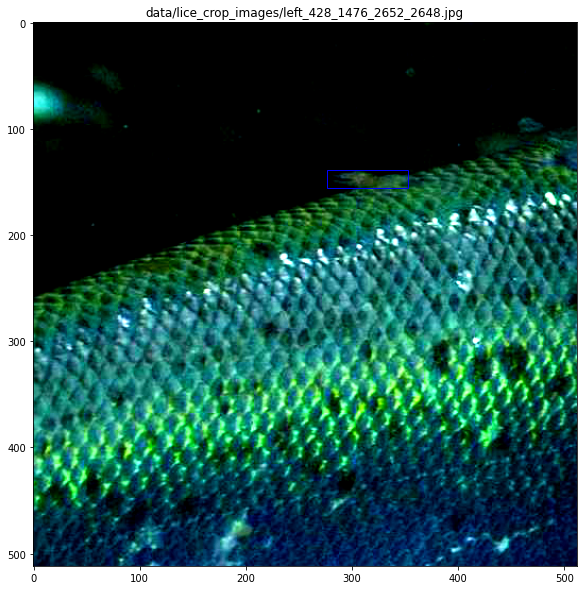

fig
[720. 720.]
data/lice_crop_images/left_1660_257_4092_1435.jpg


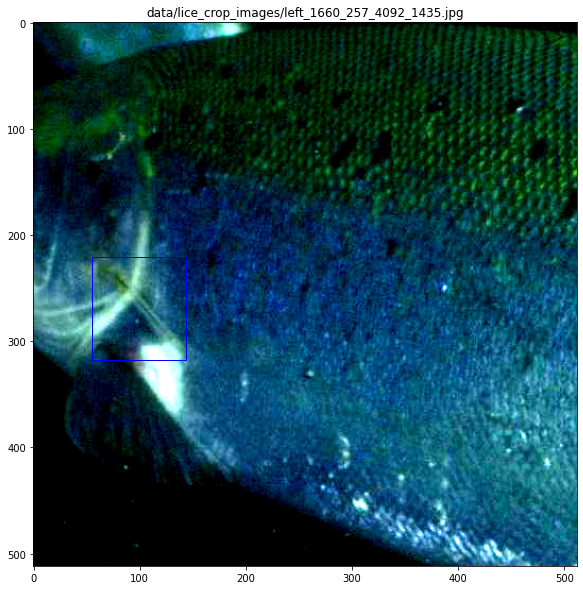

fig
[720. 720.]
data/lice_crop_images/left_778_791_3878_2354.jpg


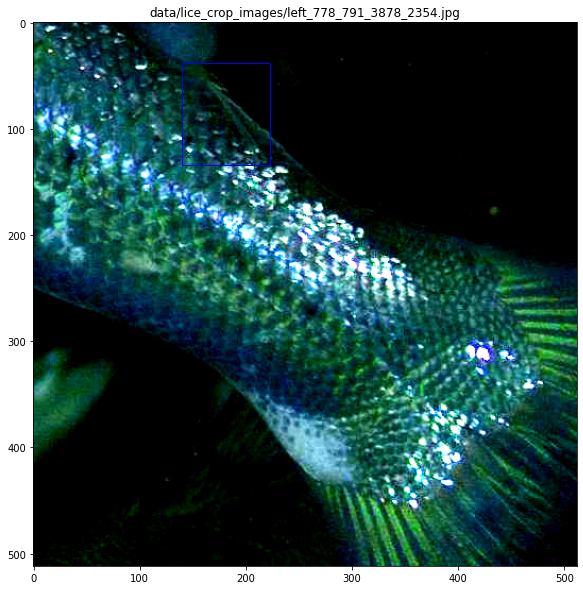

fig
[720. 720.]
data/lice_crop_images/left_0_110_2844_1154.jpg


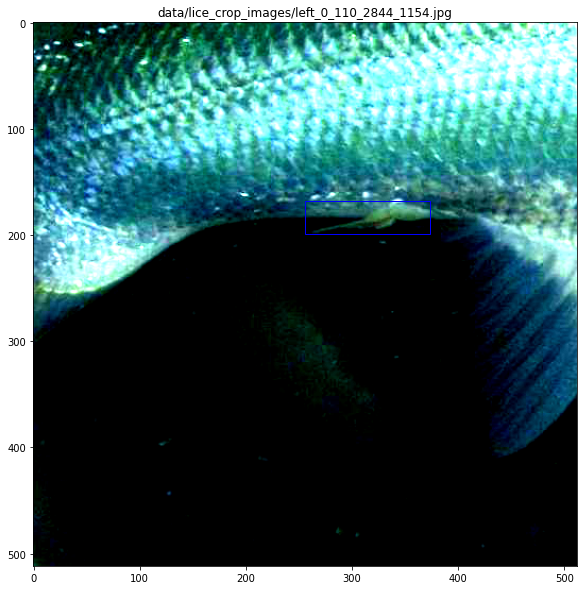

fig
[720. 720.]
data/lice_crop_images/left_1892_685_4096_1857.jpg


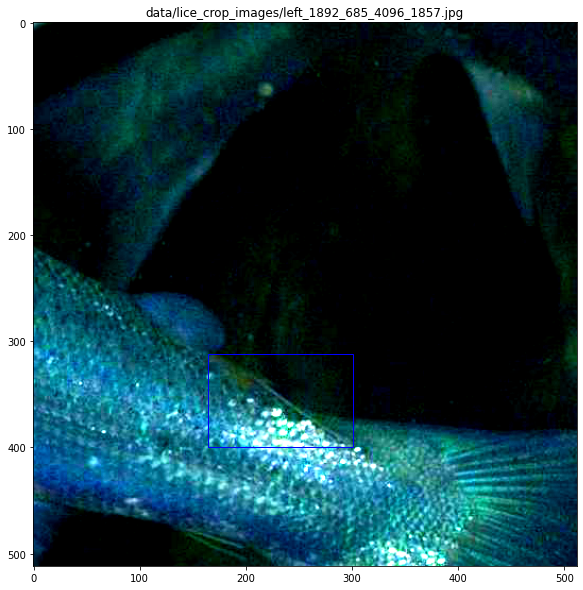

fig
[720. 720.]
data/lice_crop_images/left_1324_462_4096_1570.jpg


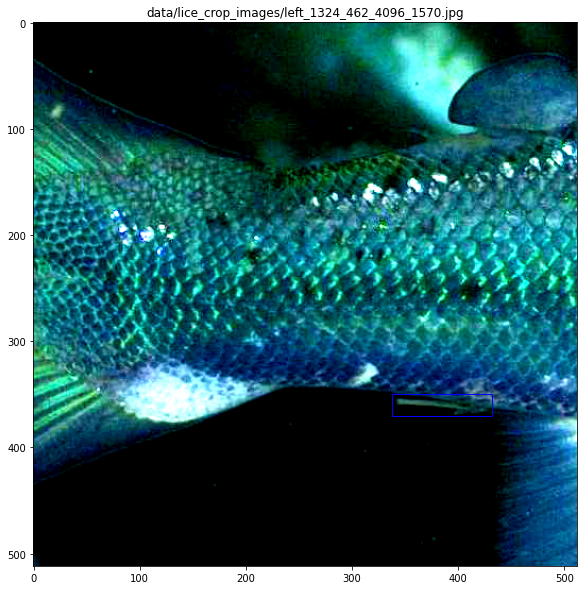

fig
[720. 720.]
data/lice_crop_images/left_2004_1722_4096_2719.jpg


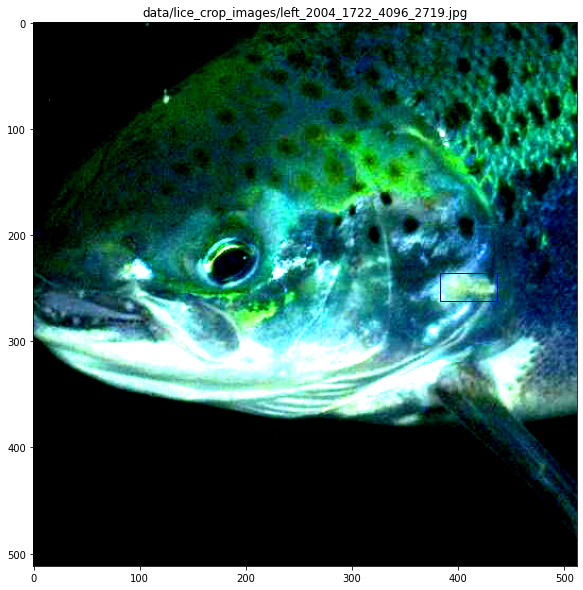

fig
[720. 720.]
data/lice_crop_images/left_1330_1072_4096_2079.jpg


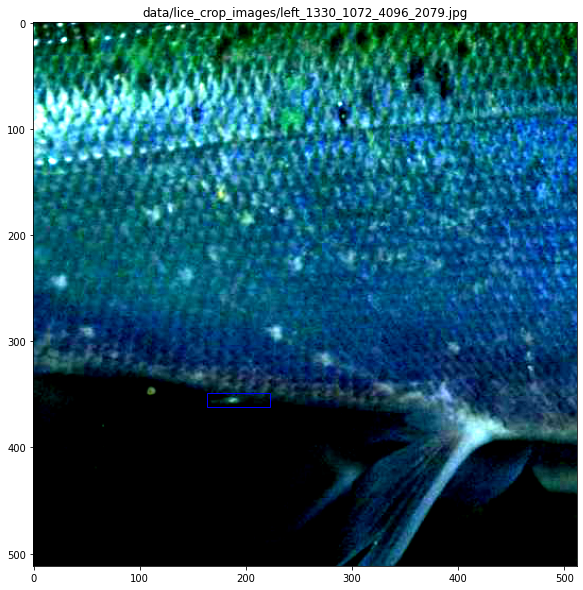

fig
[720. 720.]
data/lice_crop_images/left_1780_872_4036_2918.jpg


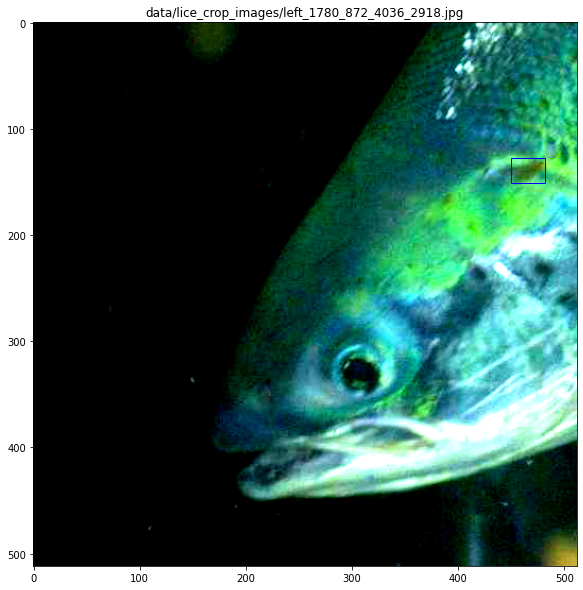

fig
[720. 720.]
data/lice_crop_images/left_1276_187_3492_1922.jpg


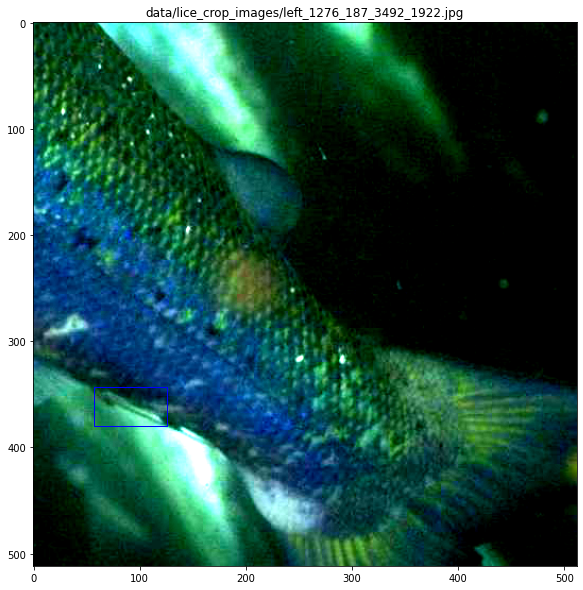

fig
[720. 720.]
data/lice_crop_images/left_374_1725_3122_2510.jpg


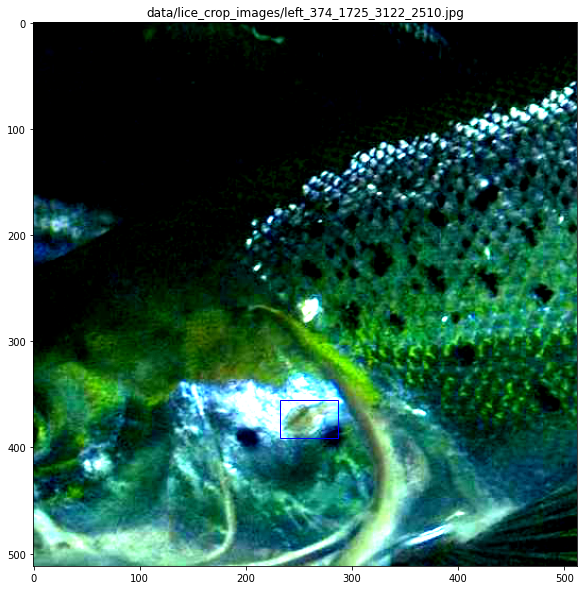

fig
[720. 720.]
data/lice_crop_images/left_942_1866_3642_2669.jpg


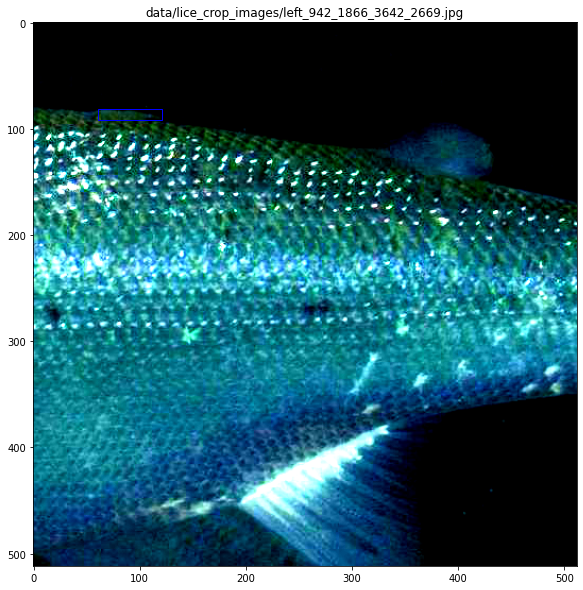

fig
[720. 720.]
data/lice_crop_images/left_1468_1441_3756_2988.jpg


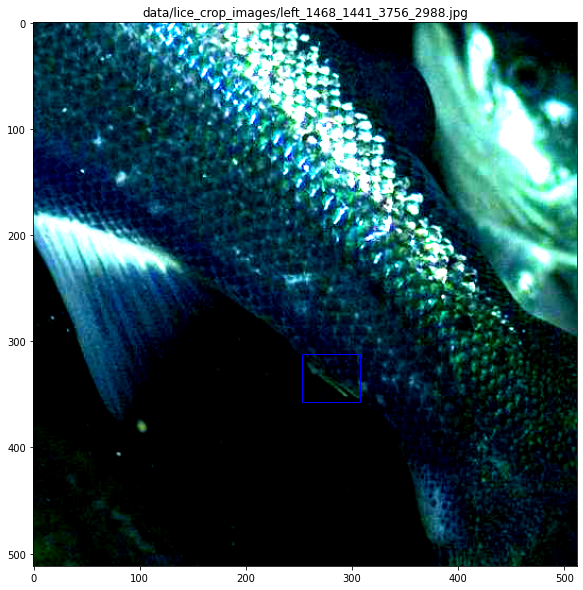

fig
[720. 720.]
data/lice_crop_images/left_0_1559_3214_3000.jpg


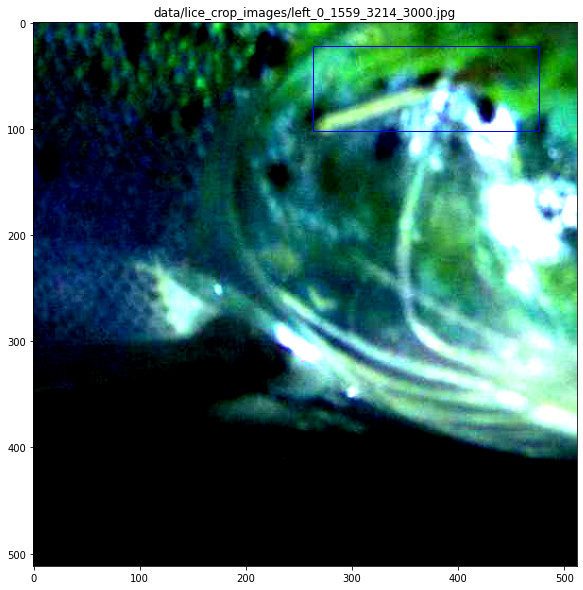

fig
[720. 720.]
data/lice_crop_images/left_810_0_3886_1593.jpg


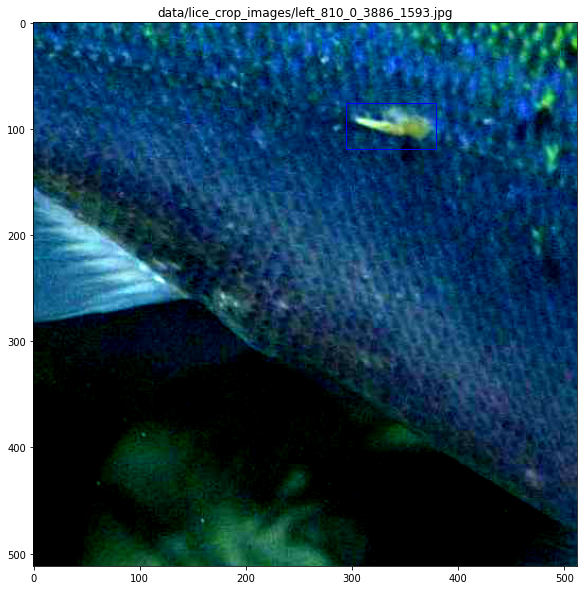

fig
[720. 720.]
data/lice_crop_images/left_0_819_2804_1975.jpg


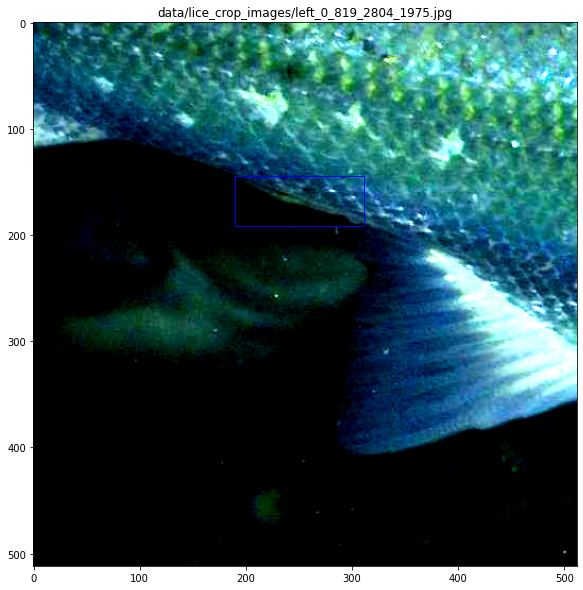

fig
[720. 720.]
data/lice_crop_images/left_0_1335_2476_2760.jpg


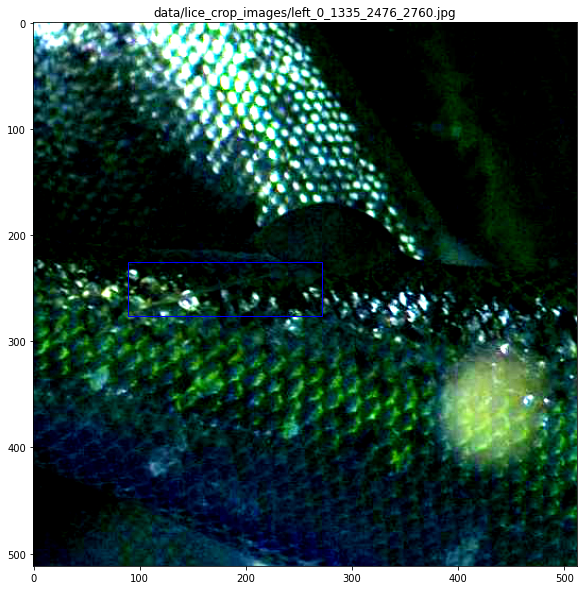

fig
[720. 720.]
data/lice_crop_images/left_1708_1288_4096_2344.jpg


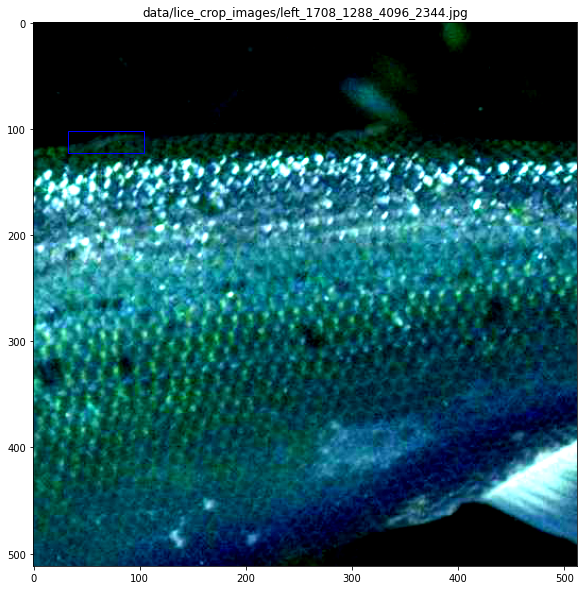

fig
[720. 720.]
data/lice_crop_images/left_0_787_2426_2399.jpg


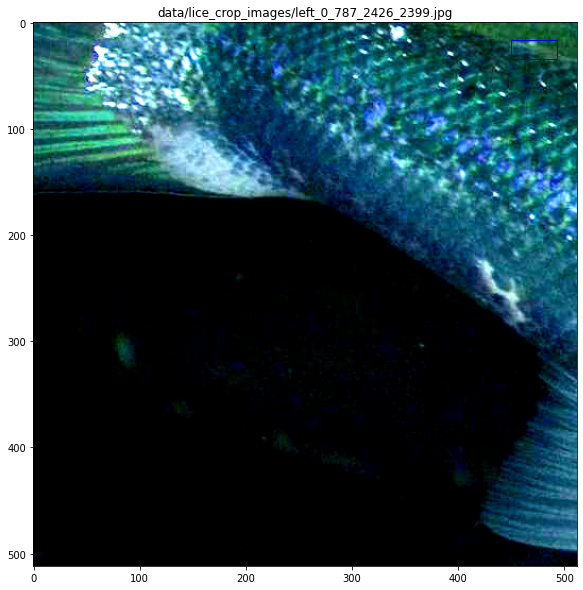

fig
[720. 720.]
data/lice_crop_images/left_182_653_3058_1538.jpg


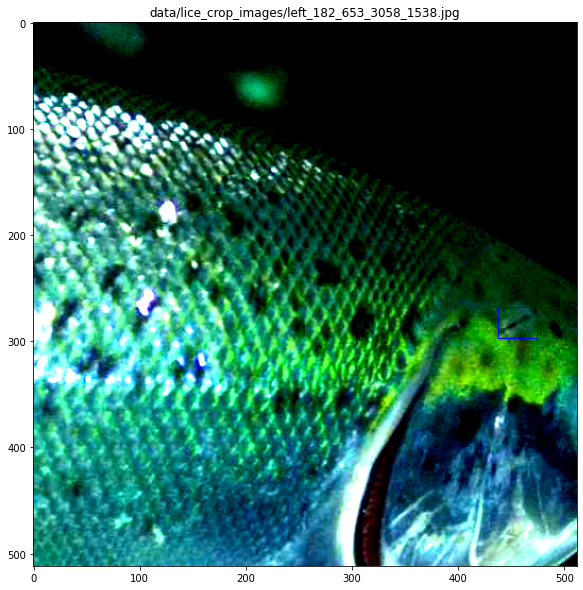

fig
[720. 720.]
data/lice_crop_images/left_0_1028_2618_1854.jpg


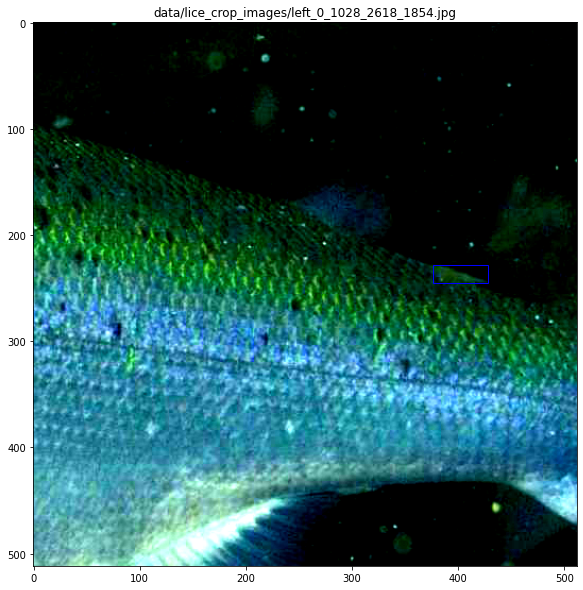

fig
[720. 720.]
data/lice_crop_images/left_1298_785_4096_2108.jpg


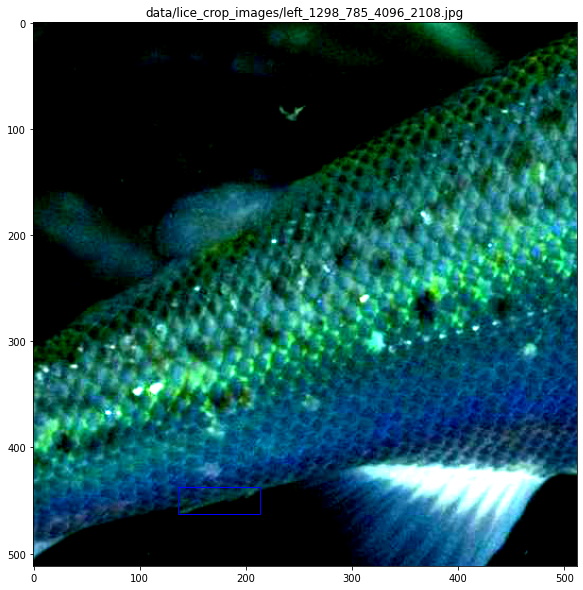

fig
[720. 720.]
data/lice_crop_images/left_1692_1388_4096_2930.jpg


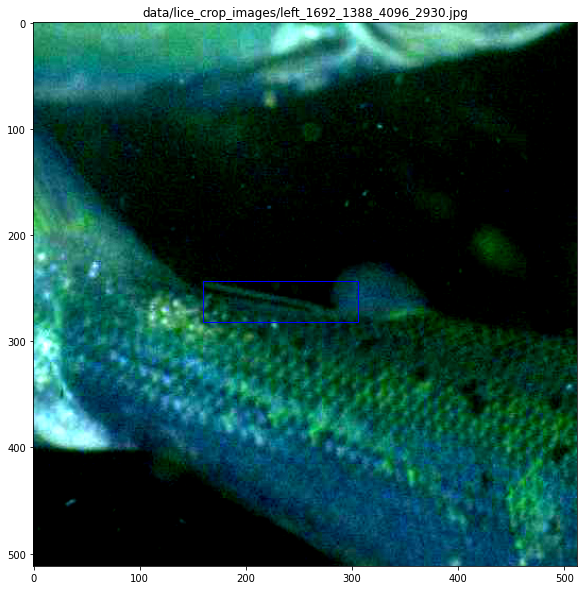

fig
[720. 720.]
data/lice_crop_images/left_1260_444_3756_1734.jpg


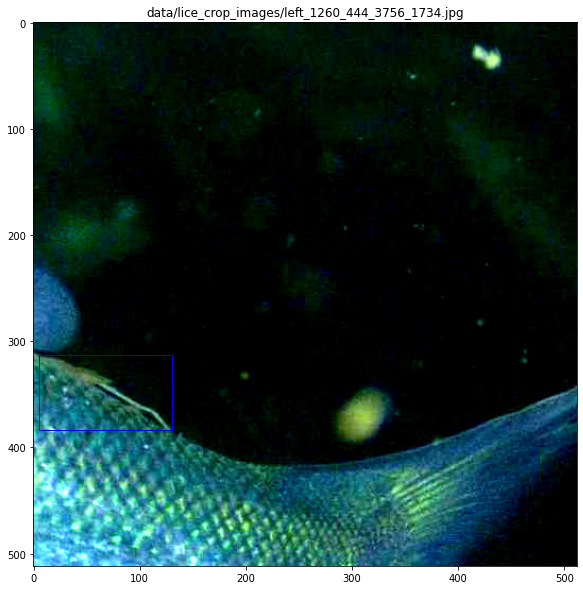

fig
[720. 720.]
data/lice_crop_images/left_34_1594_3886_2987.jpg


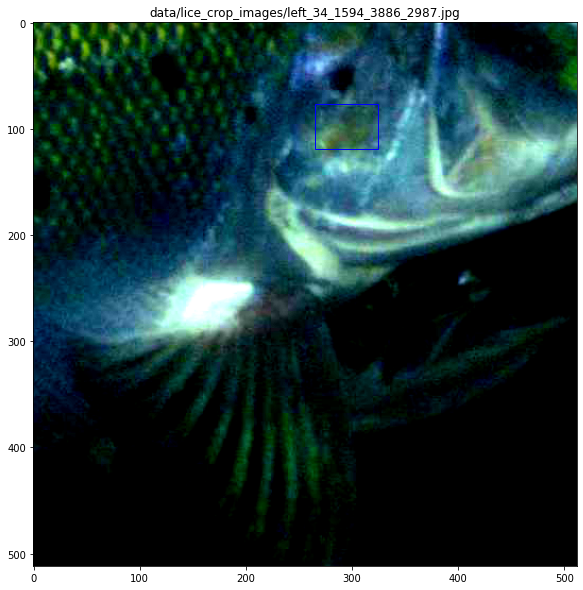

fig
[720. 720.]
data/lice_crop_images/left_154_627_3390_2143.jpg


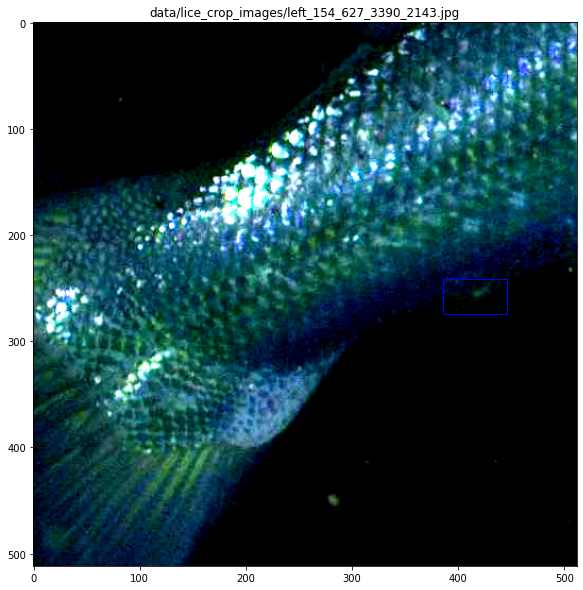

fig
[720. 720.]
data/lice_crop_images/left_342_1496_3186_2540.jpg


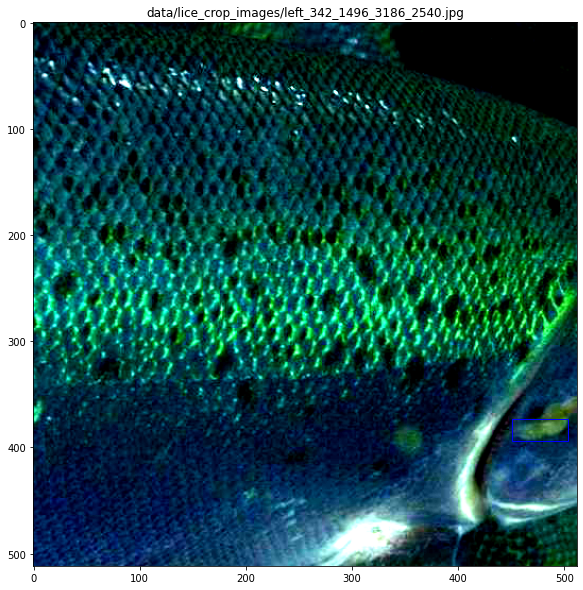

In [66]:
image_files = [join(IMAGE_PATH, f) for f in listdir(IMAGE_PATH) if isfile(join(IMAGE_PATH, f))]

for i, image_f in enumerate(image_files):
    if i < 100:
        continue
    if i > 150:
        break
    fig, ax = plt.subplots(figsize=(10, 10)) 
    #image = plt.imread(image_f)
    image = Image.open(image_f)
    print('fig')
    print(fig.get_size_inches()*fig.dpi)

    enhancer = ImageEnhance.Contrast(image)
    enhanced_im = enhancer.enhance(4.0)

    ax.imshow(enhanced_im)
    plt.title(image_f)
    
    label_path = image_f.replace("images", "labels").replace(".png", ".txt").replace(".jpg", ".txt")
    yolobbox = np.loadtxt(label_path).reshape(-1, 5)[0][1:]
    x, y, w, h = utils.yolobbox2xywh(yolobbox, [CROP_WIDTH, CROP_HEIGHT])
    rect = patches.Rectangle((x, y), w, h,linewidth=1,edgecolor="b",facecolor='none')
    
    print(image_f)
    ax.add_patch(rect)
    plt.show()

In [50]:
# copy test image in data/test.txt to folder data/test_image


for image_path in open('data/test.txt', "r").readlines():
    shutil.copy(image_path.rstrip(), "data/test_image")

In [36]:
# test 100 - 150

data/lice_crop_images/left_0_761_2484_1834.jpg
data/lice_crop_images/left_0_188_3654_1411.jpg
data/lice_crop_images/left_978_522_3734_1598.jpg
data/lice_crop_images/left_1524_808_4096_1805.jpg
data/lice_crop_images/left_610_967_3622_2366.jpg
data/lice_crop_images/left_2_1494_3054_2864.jpg
data/lice_crop_images/left_338_651_3342_2255.jpg
data/lice_crop_images/left_858_1735_4046_3000.jpg
data/lice_crop_images/left_1338_1008_3286_2852.jpg
data/lice_crop_images/left_0_110_2844_1154.jpg
data/lice_crop_images/left_1324_462_4096_1570.jpg
data/lice_crop_images/left_1468_1441_3756_2988.jpg
data/lice_crop_images/left_1260_444_3756_1734.jpg


In [35]:
# train and valid 1- 100

data/lice_crop_images/left_1210_1125_4096_2659.jpg
data/lice_crop_images/left_0_1927_2412_2812.jpg
data/lice_crop_images/left_1174_1520_3714_2651.jpg
data/lice_crop_images/left_418_1072_3190_2571.jpg
data/lice_crop_images/left_282_76_4096_1487.jpg
data/lice_crop_images/left_482_0_3366_1686.jpg
data/lice_crop_images/left_842_1336_3854_2524.jpg
data/lice_crop_images/left_874_6_4096_1288.jpg
data/lice_crop_images/left_0_1459_2566_2852.jpg
data/lice_crop_images/left_126_1016_2930_2194.jpg
data/lice_crop_images/left_1206_2018_3538_2985.jpg
data/lice_crop_images/left_698_1365_3550_2747.jpg
data/lice_crop_images/left_1444_1505_4096_2707.jpg
data/lice_crop_images/left_334_1280_2586_2645.jpg
data/lice_crop_images/left_1436_163_3700_1289.jpg
data/lice_crop_images/left_0_884_2316_1980.jpg
data/lice_crop_images/left_1590_1520_3706_2833.jpg
data/lice_crop_images/left_412_1569_3660_2848.jpg
data/lice_crop_images/left_964_1739_3348_2918.jpg
data/lice_crop_images/left_2148_1640_4020_2924.jpg
data/lice_crop_images/left_1148_1845_4028_2971.jpg
data/lice_crop_images/left_1036_1265_3572_2965.jpg
data/lice_crop_images/left_594_1365_3502_3000.jpg
data/lice_crop_images/left_786_0_2878_2220.jpg
data/lice_crop_images/left_1148_573_3732_2572.jpg
data/lice_crop_images/left_778_1037_3702_2261.jpg
data/lice_crop_images/left_1434_1236_3910_3000.jpg
data/lice_crop_images/left_714_1576_3990_2981.jpg
data/lice_crop_images/left_716_948_3260_2092.jpg


(512, 512)
output/left_610_967_3622_2366.png
data/lice_crop_labels/left_610_967_3622_2366.txt


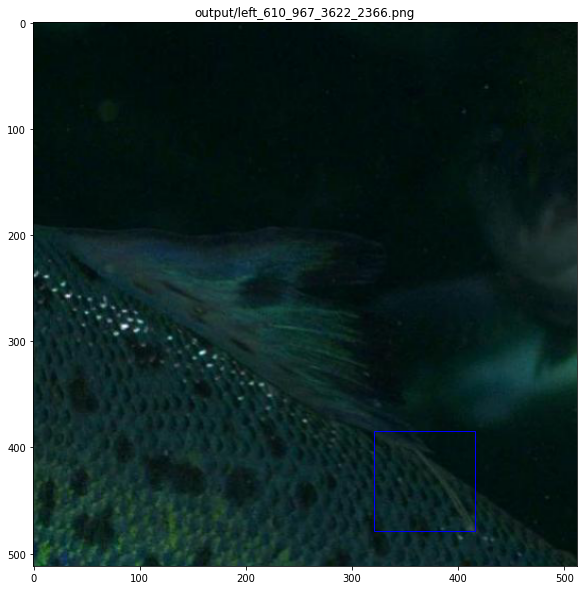

(512, 512)
output/left_1338_1008_3286_2852.png
data/lice_crop_labels/left_1338_1008_3286_2852.txt


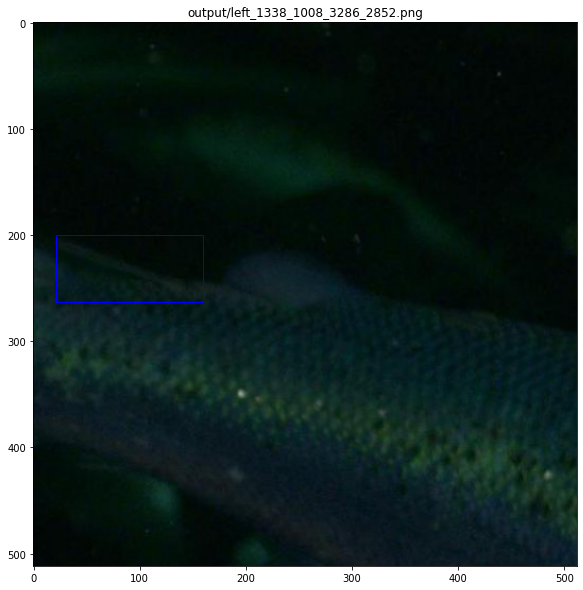

(512, 512)
output/left_978_522_3734_1598.png
data/lice_crop_labels/left_978_522_3734_1598.txt


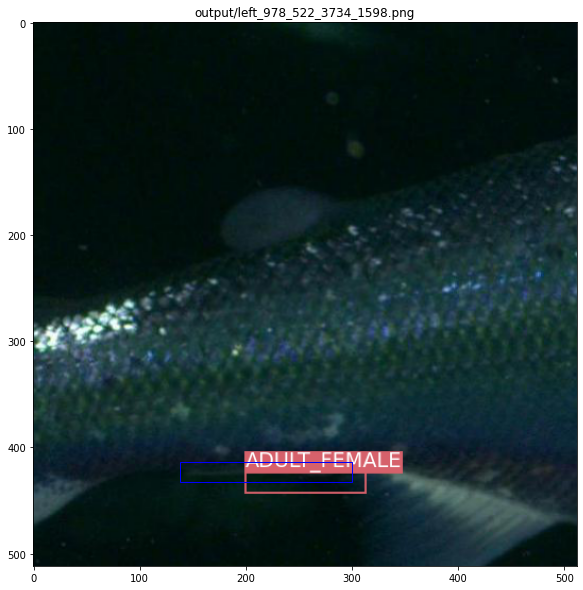

(512, 512)
output/left_0_110_2844_1154.png
data/lice_crop_labels/left_0_110_2844_1154.txt


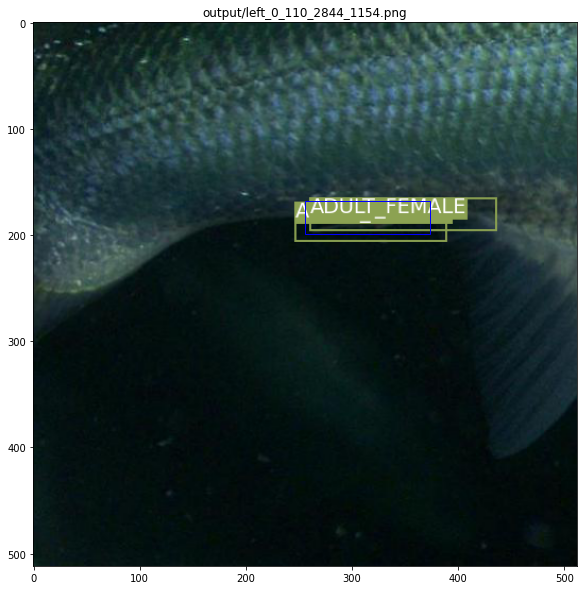

(512, 512)
output/left_1260_444_3756_1734.png
data/lice_crop_labels/left_1260_444_3756_1734.txt


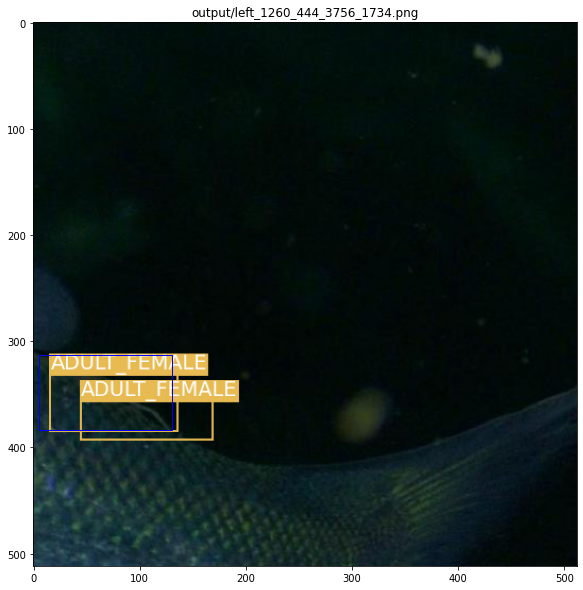

(520, 512)
output/left_0_761_2484_1834.png
data/lice_crop_labels/left_0_761_2484_1834.txt


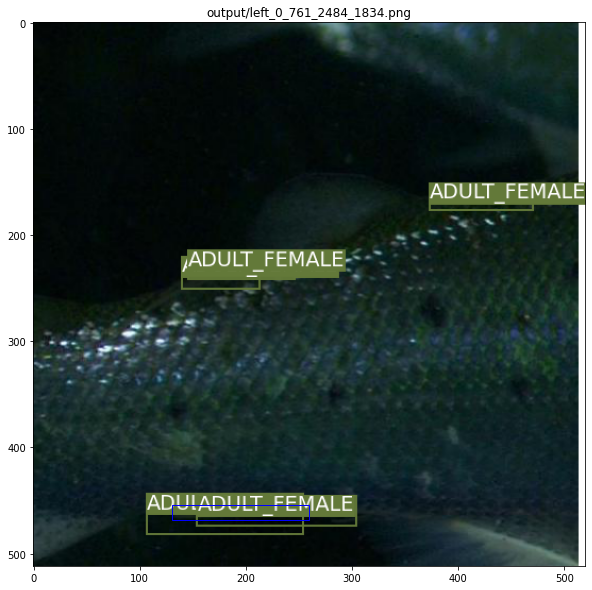

(512, 512)
output/left_338_651_3342_2255.png
data/lice_crop_labels/left_338_651_3342_2255.txt


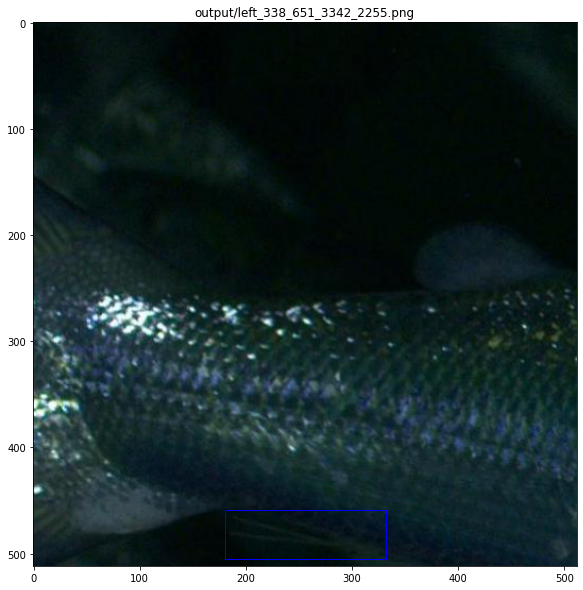

(512, 512)
output/left_2_1494_3054_2864.png
data/lice_crop_labels/left_2_1494_3054_2864.txt


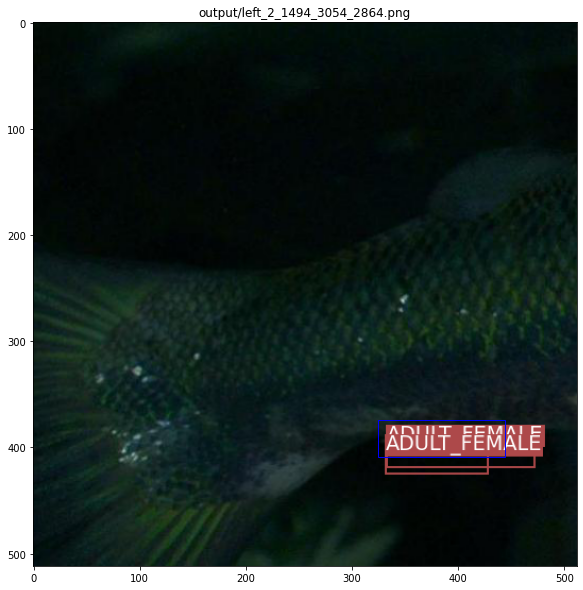

(512, 512)
output/left_858_1735_4046_3000.png
data/lice_crop_labels/left_858_1735_4046_3000.txt


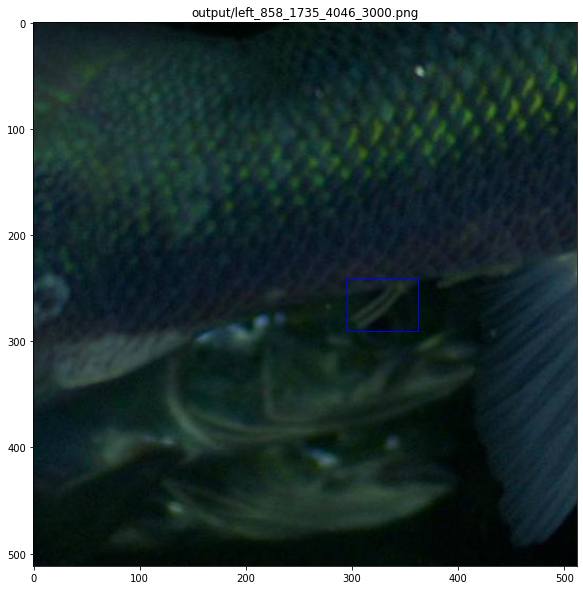

(512, 512)
output/left_1468_1441_3756_2988.png
data/lice_crop_labels/left_1468_1441_3756_2988.txt


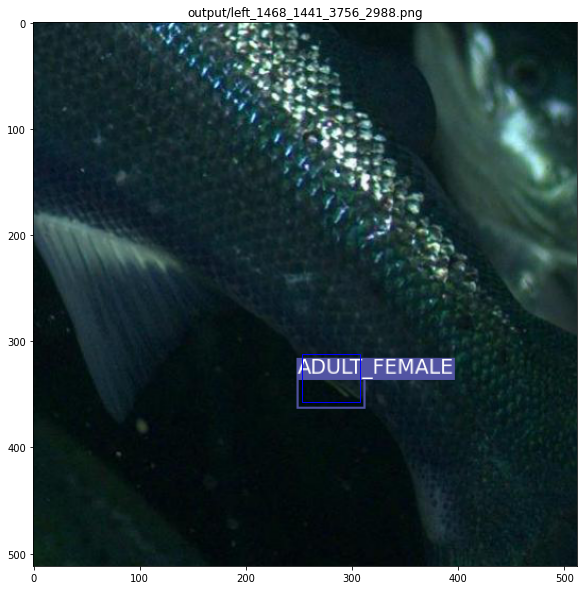

(512, 512)
output/left_1324_462_4096_1570.png
data/lice_crop_labels/left_1324_462_4096_1570.txt


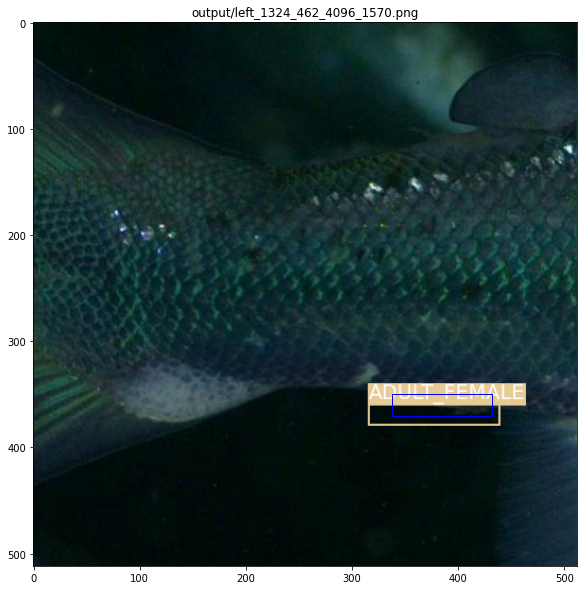

(525, 512)
output/left_1524_808_4096_1805.png
data/lice_crop_labels/left_1524_808_4096_1805.txt


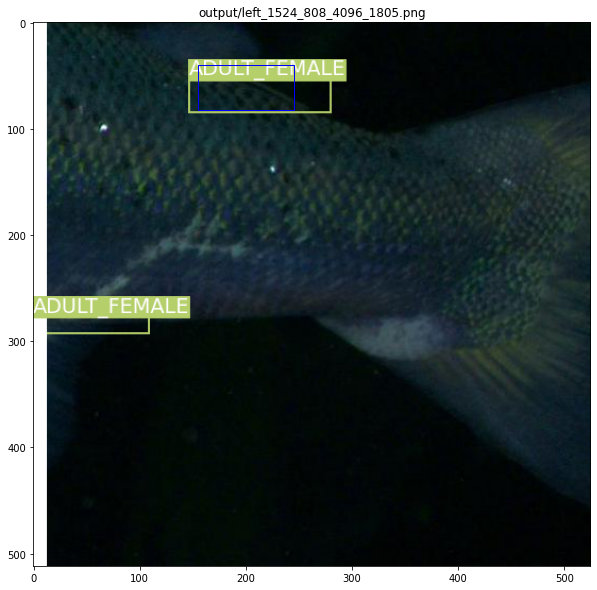

(530, 512)
output/left_0_188_3654_1411.png
data/lice_crop_labels/left_0_188_3654_1411.txt


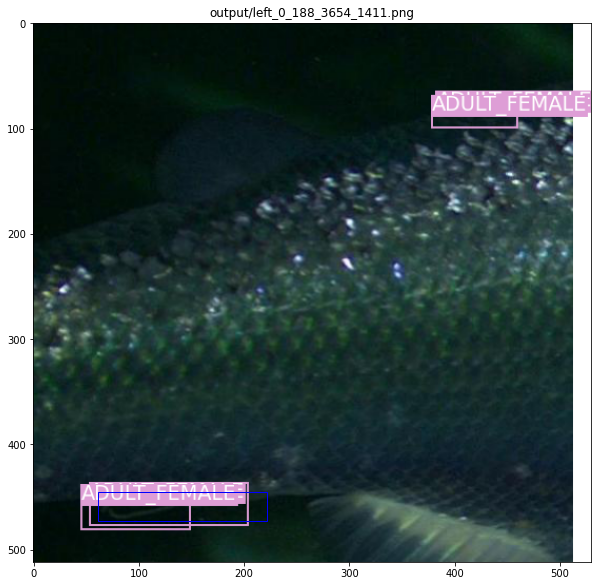

In [79]:
TEST_OUTPUT_PATH = 'output'
image_files = [join(TEST_OUTPUT_PATH, f) for f in listdir(TEST_OUTPUT_PATH) if isfile(join(TEST_OUTPUT_PATH, f))]

for i, image_f in enumerate(image_files):
    rect = None
    fig, ax = plt.subplots(figsize=(10, 10)) 


    #image = plt.imread(image_f)
    image = Image.open(image_f)

    #enhancer = ImageEnhance.Contrast(image)
    #enhanced_im = enhancer.enhance(1.5)

    ax.imshow(image)
    #print(fig.get_dpi())
    print(image.size)
    plt.title(image_f)
    label_path = image_f.replace("output", "data/lice_crop_labels").replace(".png", ".txt").replace(".jpg", ".txt")

    yolobbox = np.loadtxt(label_path).reshape(-1, 5)[0][1:]
    x, y, w, h = utils.yolobbox2xywh(yolobbox, [CROP_WIDTH, CROP_HEIGHT])
    rect = patches.Rectangle((x, y), w, h,linewidth=1,edgecolor="b",facecolor='none')
    ax.add_patch(rect)
    
    print(image_f)
    print(label_path)
    
    
    plt.show()



In [73]:
1892/512

3.6953125